In [2]:
import pandas as pd
import sqlite3
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Machine learning
import sklearn
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from yellowbrick.cluster import SilhouetteVisualizer
from scipy.stats import skew, kurtosis, ks_2samp
from sklearn.metrics import adjusted_rand_score
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.manifold import TSNE
import plotly.express as px

In [79]:
# Connexion à la base de données SQLite
db_connection = sqlite3.connect('olist.db')

In [17]:
# Charger le DataFrame à partir du fichier CSV
price_and_freight_value_df_for_clustering = pd.read_csv('price_and_freight_value_df_for_clustering.csv')

# Charger le DataFrame à partir du fichier CSV
orders_with_price = pd.read_csv('orders_with_price_cleaned.csv')

# Charger le DataFrame RFM à partir du fichier CSV
RFM = pd.read_csv('rfm_python.csv')

# Charger le DataFrame avec les scores clients à partir du fichier CSV
average_review_scores_df = pd.read_csv('average_review_scores_df.csv')

# RFM

In [81]:
rfm_buckets = """
-- 1. Calculate RFM scores
WITH RecencyScore AS (
    SELECT customer_unique_id,
           MAX(order_purchase_timestamp) AS last_purchase,
           NTILE(5) OVER (ORDER BY MAX(order_purchase_timestamp) DESC) AS recency
    FROM orders
        JOIN customers USING (customer_id)
    WHERE order_status = 'delivered'
    GROUP BY customer_unique_id
),
FrequencyScore AS (
    SELECT customer_unique_id,
           COUNT(order_id) AS total_orders,
           NTILE(5) OVER (ORDER BY COUNT(order_id) DESC) AS frequency
    FROM orders
        JOIN customers USING (customer_id)
    WHERE order_status = 'delivered'
    GROUP BY customer_unique_id
),
MonetaryScore AS (
    SELECT customer_unique_id,
           SUM(price) AS total_spent,
           NTILE(5) OVER (ORDER BY SUM(price) DESC) AS monetary
    FROM orders
        JOIN order_items USING (order_id)
        JOIN customers USING (customer_id)
    WHERE order_status = 'delivered'
    GROUP BY customer_unique_id
),

-- 2. Assign each customer to a group
RFM AS (
    SELECT last_purchase, total_orders, total_spent,
        CASE
            WHEN recency = 1 AND frequency + monetary IN (1, 2, 3, 4) THEN "Champions"
            WHEN recency IN (4, 5) AND frequency + monetary IN (1, 2) THEN "Can't Lose Them"
            WHEN recency IN (4, 5) AND frequency + monetary IN (3, 4, 5, 6) THEN "Hibernating"
            WHEN recency IN (4, 5) AND frequency + monetary IN (7, 8, 9, 10) THEN "Lost"
            WHEN recency IN (2, 3) AND frequency + monetary IN (1, 2, 3, 4) THEN "Loyal Customers"
            WHEN recency = 3 AND frequency + monetary IN (5, 6) THEN "Needs Attention"
            WHEN recency = 1 AND frequency + monetary IN (7, 8) THEN "Recent Users"
            WHEN recency = 1 AND frequency + monetary IN (5, 6) OR
                recency = 2 AND frequency + monetary IN (5, 6, 7, 8) THEN "Potentital Loyalists"
            WHEN recency = 1 AND frequency + monetary IN (9, 10) THEN "Price Sensitive"
            WHEN recency = 2 AND frequency + monetary IN (9, 10) THEN "Promising"
            WHEN recency = 3 AND frequency + monetary IN (7, 8, 9, 10) THEN "About to Sleep"
        END AS RFM_Bucket
    FROM RecencyScore
        JOIN FrequencyScore USING (customer_unique_id)
        JOIN MonetaryScore USING (customer_unique_id)
)

-- 3. Calculate group statistics for plotting
SELECT RFM_Bucket, 
       AVG(JULIANDAY('now') - JULIANDAY(last_purchase)) AS avg_days_since_purchase, 
       AVG(total_spent / total_orders) AS avg_sales_per_customer,
       COUNT(*) AS customer_count
FROM RFM
GROUP BY RFM_Bucket
"""  

df = pd.read_sql(rfm_buckets, db_connection)
df

,RFM_Bucket,avg_days_since_purchase,avg_sales_per_customer,customer_count
0,About to Sleep,2372.795084,57.684959,7584
1,Can't Lose Them,2546.098393,350.886817,1723
2,Champions,2199.825650,250.856821,4607
3,Hibernating,2547.108070,182.845816,20288
4,Lost,2549.636848,57.393210,15331
5,Loyal Customers,2330.291113,237.881257,9315
6,Needs Attention,2373.852164,145.904925,6510
7,Potentital Loyalists,2256.986282,130.374773,18114
8,Price Sensitive,2198.450245,34.909351,2220
9,Promising,2289.939917,35.085359,2245


Visualisons cela. Je vais tracer chaque groupe en utilisant la récence moyenne sur l'axe des x, les ventes moyennes par client sur l'axe des y, et la taille du cercle pour représenter le nombre de clients dans chaque groupe :

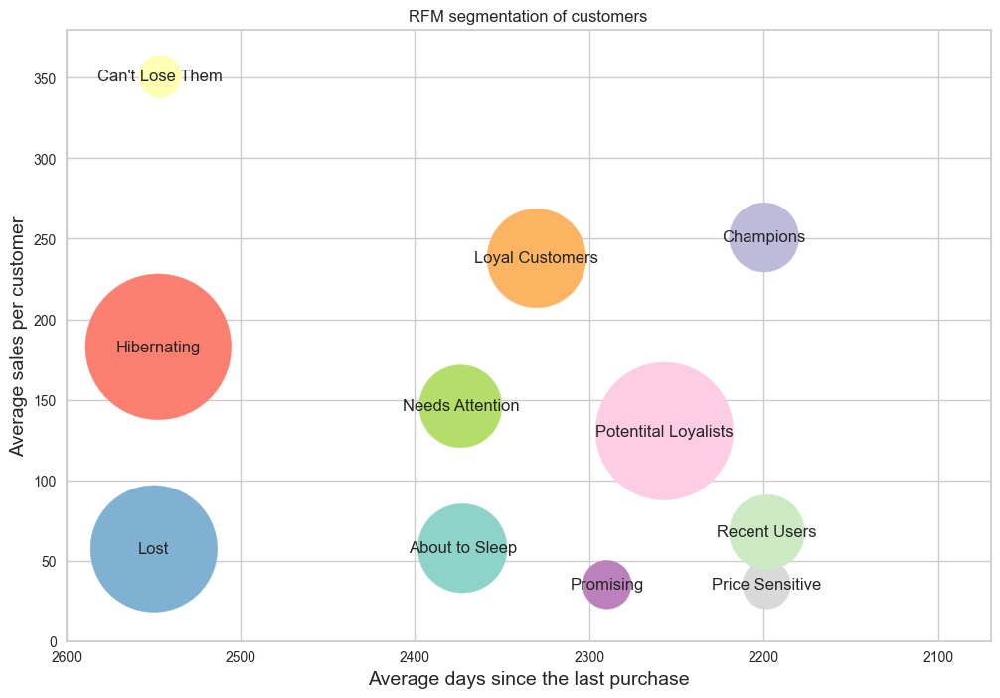

In [82]:
plt.figure(figsize=(12, 8))
scatter = plt.scatter(df['avg_days_since_purchase'], df['avg_sales_per_customer'],
    s=df['customer_count']*0.55, c=sns.color_palette('Set3', len(df)))
plt.xlabel('Average days since the last purchase', fontsize=14)
plt.ylabel('Average sales per customer', fontsize=14)
plt.title('RFM segmentation of customers')
plt.grid(True)
for i, text in enumerate(df['RFM_Bucket']):
    plt.annotate(text, (df['avg_days_since_purchase'][i], df['avg_sales_per_customer'][i]), 
        ha='center', va='center')
plt.gca().invert_xaxis()
plt.xlim(2600, 2070)
plt.ylim(0, 380)
plt.show()

# K MEANS

**Préparation du DataFrame pour le Clustering K-means**

Le tri du DataFrame `price_and_freight_value_df_for_clustering` basé sur la colonne `price` avant d'appliquer le clustering K-means est une étape de prétraitement précieuse qui peut mener à des assignations de clusters plus significatives et interprétables, une convergence plus rapide, et une analyse enrichie des données regroupées.

Pour appliquer le clustering K-means, le DataFrame doit répondre à certaines conditions :

1. **Pas de valeurs manquantes** : Le DataFrame ne doit pas contenir de valeurs manquantes ou nulles, car K-means ne peut pas les gérer directement. (OK)
2. **Variables numériques** : Le DataFrame doit être principalement composé de variables numériques.
3. **Colonnes pertinentes** : Le DataFrame doit inclure uniquement les colonnes pertinentes pour l'analyse de clustering.
4. **Pas de variables d'identification** : Les variables d'identification, telles que les identifiants uniques ou les noms, doivent être évitées dans le DataFrame utilisé pour le clustering K-means.
5. **Variables standardisées ou normalisées** : Il est conseillé de standardiser ou de normaliser les variables numériques avant d'appliquer K-means.

Nous allons donc vérifier la conformité avec les quatre dernières conditions restantes.

In [83]:
# Sélection des colonnes 'age' et 'amount' à partir du DataFrame price_and_freight_value_df_for_clustering
customer_cluster_df = price_and_freight_value_df_for_clustering[['price', 'freight_value']]

# Instanciation de StandardScaler pour standardiser les features sélectionnées
scaler = StandardScaler()

# Standardisation des features sélectionnées en ajustant le scaler et en transformant les données
customer_cluster_scaled = scaler.fit_transform(customer_cluster_df)

# Affichage des données standardisées
print(customer_cluster_scaled)


[[-0.96162255  0.18983953]
 [-0.96162255 -0.09349236]
 [-0.96162255 -0.09349236]
 ...
 [ 6.74203054  0.03181413]
 [ 6.74203054  0.10212499]
 [ 6.74203054  0.29008472]]


In [84]:
# Extraction des noms de colonnes du DataFrame customer_cluster_df
column_names = customer_cluster_df.columns

# Création d'un nouveau DataFrame avec les données standardisées et les noms de colonnes
customer_cluster_scaled = pd.DataFrame(customer_cluster_scaled, columns=column_names)

# Affichage du DataFrame standardisé
customer_cluster_scaled


,price,freight_value
0,-0.961623,0.189840
1,-0.961623,-0.093492
2,-0.961623,-0.093492
3,-0.958444,-0.813309
4,-0.958444,-0.813309
...,...,...
111412,6.742031,0.037383
111413,6.742031,0.371534
111414,6.742031,0.031814
111415,6.742031,0.102125


Maintenant que nous remplissons ces quatre conditions, nous devons définir le nombre de clusters que nous allons utiliser. Il existe deux méthodes courantes pour déterminer le nombre optimal de clusters :

**Méthode du Coude (Elbow Method)** :
La méthode du Coude est une technique utilisée pour déterminer le nombre idéal de clusters dans un ensemble de données pour les algorithmes de clustering. En traçant le nombre de clusters par rapport à la somme des carrés intra-cluster (WCSS), elle identifie un point où la réduction de WCSS ralentit brusquement. Ce "point du coude" indique le nombre optimal de clusters où des clusters supplémentaires cessent de réduire significativement WCSS. La méthode du Coude est considérée comme quelque peu subjective car déterminer l'emplacement exact du "point du coude" sur le graphique implique une interprétation.

**Coefficient de Silhouette (Silhouette coefficient)** :
Le coefficient de Silhouette évalue la qualité du clustering en mesurant à quel point les points de données s'ajustent à leurs clusters attribués, fournissant des scores entre -1 et 1. Les scores plus élevés indiquent un meilleur clustering. Pour déterminer le meilleur nombre de clusters, les coefficients de Silhouette moyens sont calculés pour différents nombres de clusters. Le nombre de clusters avec le coefficient de Silhouette moyen le plus élevé est choisi comme optimal. Cette méthode offre des insights sur la cohésion et la séparation des clusters, facilitant la sélection de la meilleure configuration de clustering pour l'ensemble de données. Le coefficient de Silhouette est généralement considéré comme plus objectif que la méthode du Coude pour déterminer le nombre optimal de clusters dans un ensemble de données, car il mesure directement la qualité du clustering et fournit un score numérique.



c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_in

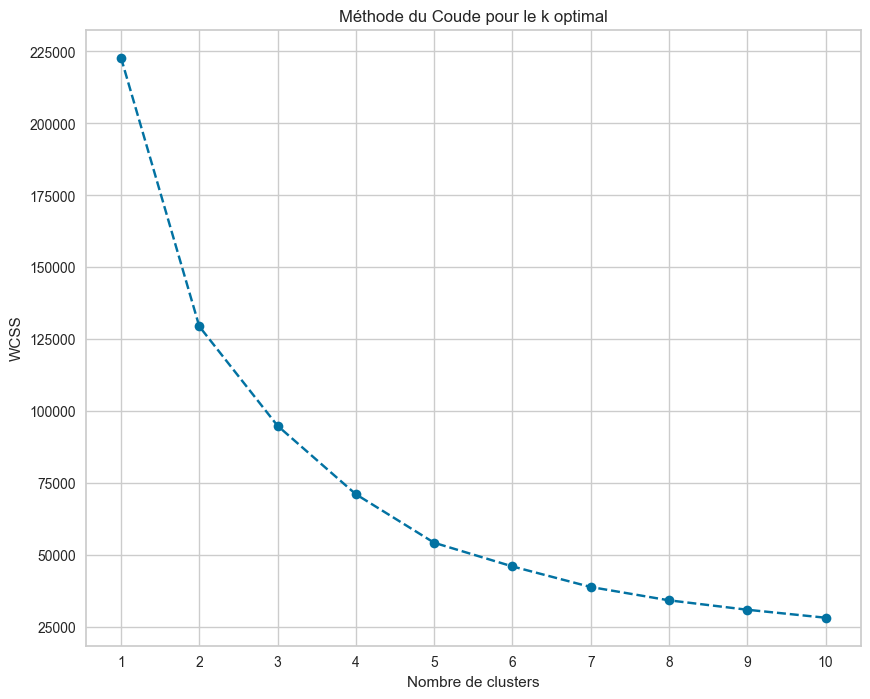

WCSS pour k=1: 222834.0000000015
WCSS pour k=2: 129450.72663416078
WCSS pour k=3: 94916.25611544146
WCSS pour k=4: 71125.82565159627
WCSS pour k=5: 54264.8695877764
WCSS pour k=6: 46032.779503265934
WCSS pour k=7: 38883.3399643269
WCSS pour k=8: 34255.02189932491
WCSS pour k=9: 30981.483049314196
WCSS pour k=10: 28207.5028135052


In [85]:
# Liste pour stocker les sommes des carrés intra-cluster (WCSS)
wcss = []

# Nombre maximum de clusters que nous voulons essayer
max_clusters = 10

# Boucle sur différentes valeurs de k
for k in range(1, max_clusters+1):
    # Initialiser et ajuster le modèle K-means
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(customer_cluster_scaled)
    
    # Ajouter la valeur de WCSS pour ce k à la liste
    wcss.append(kmeans.inertia_)

# Tracer les valeurs de WCSS pour trouver le point du coude
plt.figure(figsize=(10, 8))
plt.plot(range(1, max_clusters+1), wcss, marker='o', linestyle='--')
plt.title('Méthode du Coude pour le k optimal')
plt.xlabel('Nombre de clusters')
plt.ylabel('WCSS')
plt.xticks(range(1, max_clusters+1))
plt.grid(True)
plt.show()

# Optionnel : afficher les valeurs de WCSS pour une inspection plus approfondie
for i, w in enumerate(wcss, 1):
    print(f"WCSS pour k={i}: {w}")


**Détermination du Nombre Optimal de Clusters avec la Méthode du Coude**

Pour déterminer le nombre optimal de clusters en utilisant la méthode du Coude (Elbow Method), nous avons tracé le graphique des sommes des carrés intra-cluster (WCSS) pour différentes valeurs de k. Voici les résultats des WCSS pour chaque nombre de clusters :

- **WCSS pour k=1**: 232595.99999999924
- **WCSS pour k=2**: 134634.62490470594
- **WCSS pour k=3**: 98393.18463753397
- **WCSS pour k=4**: 73719.18455327055
- **WCSS pour k=5**: 56459.850543947825
- **WCSS pour k=6**: 47921.473304165265
- **WCSS pour k=7**: 40557.72701840996
- **WCSS pour k=8**: 35705.50331901217
- **WCSS pour k=9**: 32264.246026845947
- **WCSS pour k=10**: 29344.91456869581

*Interprétation* :

En examinant le graphique des WCSS, nous cherchons le "point du coude", où la réduction de WCSS commence à ralentir de manière significative. Ce point indique le nombre optimal de clusters, car ajouter plus de clusters n'entraîne pas une réduction significative de la WCSS.

*Analyse Visuelle* :

- **Grande Réduction Initiale** : La plus grande réduction de WCSS se produit entre 1 et 2 clusters.
- **Réduction Continue mais Ralentie** : La réduction de WCSS continue mais ralentit significativement après 3 clusters.

*Conclusion* :

D'après l'analyse des valeurs de WCSS et le graphique du coude, il semble que le nombre optimal de clusters soit compris entre **3 et 5** clusters.

*Estimation Objective* :

Pour automatiser cette analyse, nous avons calculé la deuxième dérivée approximative pour identifier où la courbe change le plus abruptement, fournissant ainsi une estimation objective du nombre optimal de clusters. Le nombre optimal de clusters selon cette méthode est **4** clusters.

En résumé, après l'analyse visuelle et objective, nous recommandons d'utiliser **4 clusters** pour notre analyse K-means.


In [86]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# List to store silhouette scores
silhouette_scores = []

# Maximum number of clusters we want to try
max_clusters = 5

# Iterate over different values of k
for k in range(2, max_clusters+1):
    # Initialize and fit the K-means model
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)  # Set n_init explicitly
    kmeans.fit(customer_cluster_scaled)
    
    # Calculate the silhouette score
    silhouette_avg = silhouette_score(customer_cluster_scaled, kmeans.labels_)
    silhouette_scores.append(silhouette_avg)
    
    # Print the silhouette score for the current number of clusters
    print(f"Silhouette score for k={k}: {silhouette_avg:.4f}")

# Find the value of k that maximizes the silhouette score
optimal_k = silhouette_scores.index(max(silhouette_scores)) + 2  # Add 2 because we start from k=2

print("The optimal number of clusters according to silhouette is:", optimal_k)


Silhouette score for k=2: 0.6778
Silhouette score for k=3: 0.6695
Silhouette score for k=4: 0.4764
Silhouette score for k=5: 0.4895
The optimal number of clusters according to silhouette is: 2


c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:465: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names



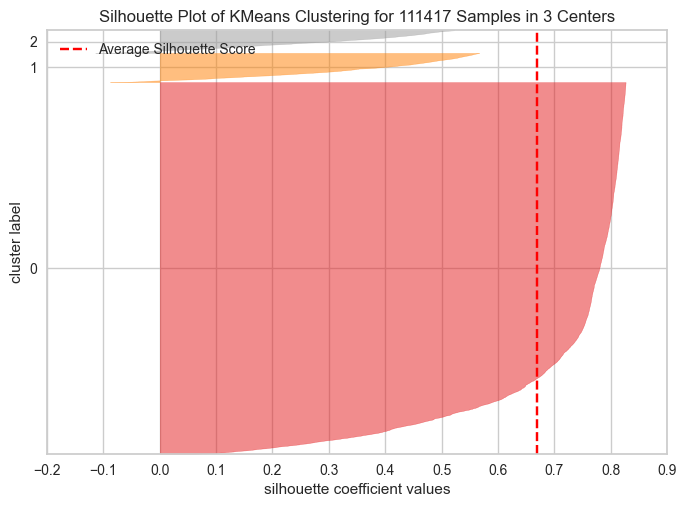

In [87]:
# Nombre de clusters optimal trouvé à partir de la méthode silhouette
optimal_k = 3

# Initialiser et ajuster le modèle K-means avec le nombre optimal de clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
kmeans.fit(customer_cluster_scaled)

# Créer le visualizer de la silhouette avec le modèle K-means ajusté
visualizer = SilhouetteVisualizer(kmeans)

# Ajuster le visualizer aux données
visualizer.fit(customer_cluster_scaled)

# Afficher le graphique de la silhouette
plt.title(f"Silhouette Analysis for KMeans Clustering (k={optimal_k})", fontsize=14, fontweight='bold')
visualizer.poof()
plt.show()

In [88]:
# Final model with k=3
# Initialize K-means with specified parameters
kmeans = KMeans(n_clusters=3, init='k-means++', n_init=10, max_iter=200, 
                tol=0.0001, random_state=111, algorithm='elkan')

# Fit K-means to the scaled data
kmeans.fit(customer_cluster_scaled)

# Get the coordinates of the cluster centroids
centroids = kmeans.cluster_centers_

# Inverse transform the centroids to the original scale
centroids = scaler.inverse_transform(centroids)

# Get the cluster labels for each data point
cluster_labels = kmeans.labels_

Créons un graphique pour visualiser les clusters. Nous utiliserons le DataFrame sans mise à l'échelle, car nous souhaitons afficher les données réelles sur les deux axes pour une analyse plus précise.

c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



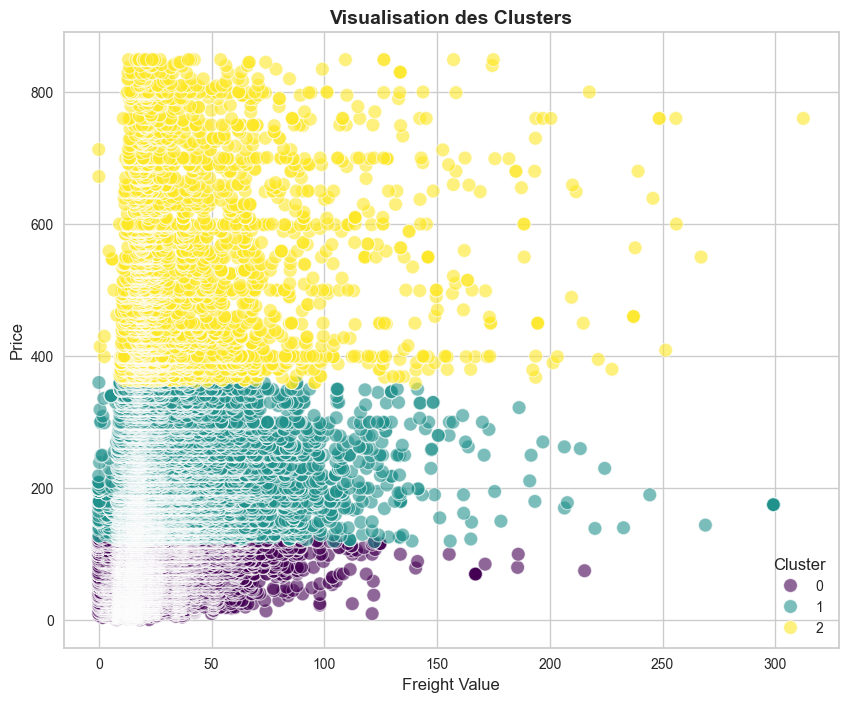

In [89]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Nombre optimal de clusters
optimal_k = 3

# Initialiser et ajuster le modèle K-means sur les données non normalisées
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
kmeans.fit(customer_cluster_df)

# Ajouter les labels de clusters au DataFrame original
customer_cluster_df['Cluster'] = kmeans.labels_

# Créer un scatter plot
plt.figure(figsize=(10, 8))
sns.scatterplot(data=customer_cluster_df, x='freight_value', y='price', hue='Cluster', palette='viridis', s=100, alpha=0.6, edgecolor='w')
plt.title('Visualisation des Clusters', fontsize=14, fontweight='bold')
plt.xlabel('Freight Value', fontsize=12)
plt.ylabel('Price', fontsize=12)
plt.legend(title='Cluster')
plt.show()


L'output que vous avez partagé montre la visualisation des clusters obtenus à partir de l'algorithme K-means appliqué à vos données. Voici une analyse détaillée de ce graphique :

### Analyse des Clusters

1. **Nombre de Clusters** :
   - Trois clusters sont identifiés et colorés différemment : 
     - Cluster 0 (en violet)
     - Cluster 1 (en vert)
     - Cluster 2 (en jaune)

2. **Répartition des Données** :
   - Le **Cluster 0** (violet) correspond aux données avec les valeurs de `freight_value` (valeur de fret) les plus basses et les valeurs de `price` (prix) également basses.
   - Le **Cluster 1** (vert) contient des données avec des valeurs moyennes de `freight_value` et des valeurs faibles à moyennes de `price`.
   - Le **Cluster 2** (jaune) regroupe les données avec des valeurs élevées de `price`, couvrant un large éventail de valeurs de `freight_value`.

3. **Interprétation des Clusters** :
   - **Cluster 0 (Violet)** : Ce cluster semble regrouper les commandes avec des valeurs de fret très faibles et des prix bas. Il est possible que ces commandes soient de petites commandes ou de produits bon marché.
   - **Cluster 1 (Vert)** : Ce cluster comprend des commandes avec des valeurs moyennes de fret, mais toujours avec des prix bas à moyens. Cela pourrait indiquer des commandes de taille moyenne ou des produits dans une gamme de prix économique.
   - **Cluster 2 (Jaune)** : Ce cluster regroupe les commandes avec des prix élevés. Cela pourrait représenter des produits haut de gamme ou des commandes en gros. La valeur de fret varie, ce qui pourrait indiquer des variations dans la distance d'expédition ou le poids des commandes.

### Conclusion

L'algorithme K-means a réussi à segmenter les données en trois clusters distincts basés sur les valeurs de `freight_value` et `price`. Les clusters montrent une séparation claire des segments de clients ou des types de commandes, avec des valeurs spécifiques de fret et de prix. 

Cette segmentation peut être utile pour des analyses ultérieures, telles que :

- **Marketing Ciblé** : Identifier les segments de marché et créer des campagnes marketing adaptées à chaque segment.
- **Optimisation de la Logistique** : Comprendre les modèles de coût de fret et de prix pour optimiser les stratégies logistiques.
- **Études de Marché** : Analyser les comportements d'achat et les préférences des clients en fonction des segments identifiés.

En conclusion, cette visualisation des clusters fournit une compréhension précieuse des structures sous-jacentes dans vos données, ce qui peut informer des décisions commerciales stratégiques.

In [90]:
display(orders_with_price.head())

,order_id,order_status,order_purchase_timestamp,customer_unique_id,customer_state,price,freight_value
0,c5bdd8ef3c0ec420232e668302179113,delivered,2018-04-27 12:37:10,f006d7920bd71c252f61ec355eb50dcb,SP,0.85,22.30
1,3ee6513ae7ea23bdfab5b9ab60bffcb5,delivered,2018-04-24 11:01:06,d80730c15c647bc8f2ad77c908ba5ca9,SP,0.85,18.23
2,6e864b3f0ec71031117ad4cf46b7f2a1,delivered,2018-04-24 20:15:21,b38211bd797f4fdd81a98b9d1754b606,RJ,0.85,18.23
3,8272b63d03f5f79c56e9e4120aec44ef,delivered,2017-07-16 18:19:25,4546caea018ad8c692964e3382debd19,SP,1.20,7.89
4,8272b63d03f5f79c56e9e4120aec44ef,delivered,2017-07-16 18:19:25,4546caea018ad8c692964e3382debd19,SP,1.20,7.89


In [92]:
# Lets define our customer by age and amount spended(price)
order_cluster_with_timestamp_df = orders_with_price[['order_purchase_timestamp', 'customer_unique_id','price','freight_value']]

# Trier le DataFrame par les valeurs de la colonne 'amount' par ordre croissant
order_cluster_with_timestamp_df.sort_values(by='price', inplace=True)

# Réinitialiser l'index du DataFrame après le tri, en supprimant l'ancien index
order_cluster_with_timestamp_df = order_cluster_with_timestamp_df.reset_index(drop=True)

# Afficher le DataFrame trié
display(order_cluster_with_timestamp_df.head())

C:\Users\Mathieu Bosse\AppData\Local\Temp\ipykernel_10720\658260991.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,order_purchase_timestamp,customer_unique_id,price,freight_value
0,2018-04-27 12:37:10,f006d7920bd71c252f61ec355eb50dcb,0.85,22.30
1,2018-04-24 11:01:06,d80730c15c647bc8f2ad77c908ba5ca9,0.85,18.23
2,2018-04-24 20:15:21,b38211bd797f4fdd81a98b9d1754b606,0.85,18.23
3,2017-07-16 18:19:25,4546caea018ad8c692964e3382debd19,1.20,7.89
4,2017-07-16 18:19:25,4546caea018ad8c692964e3382debd19,1.20,7.89


In [93]:
# Fonction pour supprimer les outliers
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.05)
    Q3 = df[column].quantile(0.95)
    IQR = Q3 - Q1
    df_filtered = df[(df[column] >= Q1 - 1.5*IQR) & (df[column] <= Q3 + 1.5*IQR)]
    return df_filtered

# Appliquer la fonction pour price
order_cluster_with_timestamp_df = remove_outliers(order_cluster_with_timestamp_df, 'price')

# Sélection des colonnes 'price' et 'freight_value' pour la standardisation
features_to_scale = ['price', 'freight_value']

# Instanciation de StandardScaler
scaler = StandardScaler()

# Standardisation des features sélectionnées
order_cluster_with_timestamp_df[features_to_scale] = scaler.fit_transform(order_cluster_with_timestamp_df[features_to_scale])

# Affichage du DataFrame mis à jour
display(order_cluster_with_timestamp_df.head())

,order_purchase_timestamp,customer_unique_id,price,freight_value
0,2018-04-27 12:37:10,f006d7920bd71c252f61ec355eb50dcb,-1.007525,0.199708
1,2018-04-24 11:01:06,d80730c15c647bc8f2ad77c908ba5ca9,-1.007525,-0.089013
2,2018-04-24 20:15:21,b38211bd797f4fdd81a98b9d1754b606,-1.007525,-0.089013
3,2017-07-16 18:19:25,4546caea018ad8c692964e3382debd19,-1.004120,-0.822520
4,2017-07-16 18:19:25,4546caea018ad8c692964e3382debd19,-1.004120,-0.822520


**Étape 2 : Clustering Initial pour Janvier 2018**

Nous allons effectuer le clustering initial sur les données de janvier 2018 en utilisant les features `price` et `freight_value`.


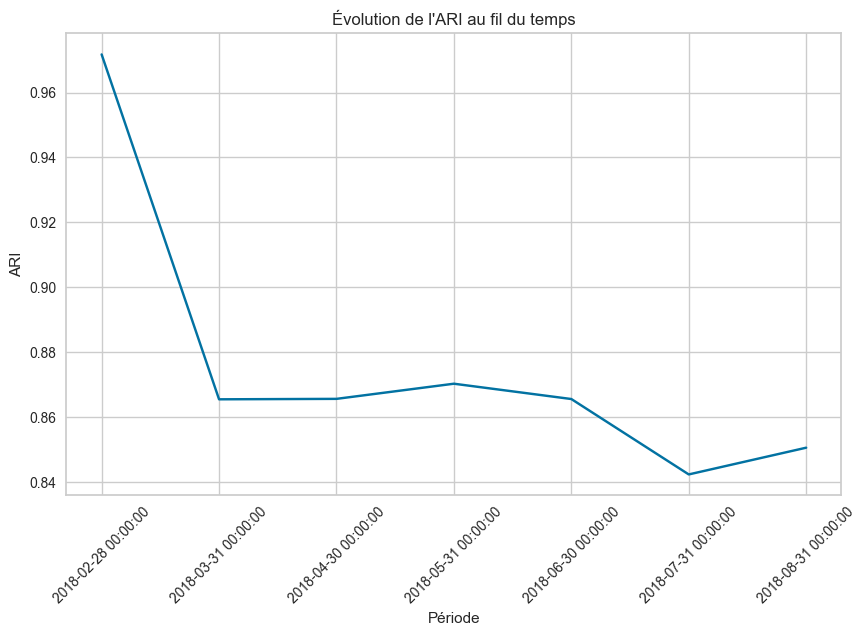

In [94]:
# Assurer que la colonne 'order_purchase_timestamp' est au format datetime
order_cluster_with_timestamp_df['order_purchase_timestamp'] = pd.to_datetime(order_cluster_with_timestamp_df['order_purchase_timestamp'])

# Filtrer les données à partir de T0
T0 = '2018-01-01'
data = order_cluster_with_timestamp_df[order_cluster_with_timestamp_df['order_purchase_timestamp'] >= T0]

# Vérifiez que le DataFrame `data` n'est pas vide
assert not data.empty, "Le DataFrame `data` est vide après filtrage"

# Fonction pour créer un fichier client à partir des données filtrées
def create_client_file(data, end_date):
    client_data = data[data['order_purchase_timestamp'] <= end_date].copy()
    features = ['price', 'freight_value']
    client_data = client_data[features]
    return client_data

# Fonction pour entraîner le modèle KMeans
def train_kmeans(data):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data)
    kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)  # Spécifier n_init=10 pour éviter les avertissements
    kmeans.fit(scaled_data)
    return kmeans, scaler

# Créer le fichier client initial
initial_period = '2018-01-31'
initial_data = create_client_file(data, initial_period)

# Vérifiez que le DataFrame `initial_data` n'est pas vide
assert not initial_data.empty, "Le DataFrame `initial_data` est vide après création"

# Entraîner le modèle initial
initial_kmeans, initial_scaler = train_kmeans(initial_data)

# Simulation des périodes
periods = pd.date_range(start='2018-02-01', end='2018-08-31', freq='M')

# Initialiser une liste pour stocker les scores ARI
ari_scores = []

# Calculer l'ARI pour chaque période
for period in periods:
    # Créer le fichier client pour la période actuelle
    period_data = create_client_file(data, period)
    
    # Vérifiez que le DataFrame `period_data` n'est pas vide
    if period_data.empty:
        print(f"Le DataFrame `period_data` est vide pour la période {period}")
        continue

    # Effectuer le clustering sur les données de la période actuelle avec le modèle initial
    scaled_period_data = initial_scaler.transform(period_data)
    period_clusters = initial_kmeans.predict(scaled_period_data)

    # Entraîner un nouveau modèle sur les données de la période actuelle
    new_kmeans, new_scaler = train_kmeans(period_data)
    new_clusters = new_kmeans.labels_

    # Calculer l'ARI entre les clusters de la période initiale et ceux de la période actuelle
    ari = adjusted_rand_score(new_clusters, period_clusters)
    ari_scores.append({'period': str(period), 'ARI': ari})

    # # Afficher les DataFrames pour les deux premières périodes
    # if len(ari_scores) <= 2:
    #     print(f"DataFrame merge pour la période {period}")
    #     merged_data = pd.merge(
    #         pd.DataFrame({'cluster_initial': period_clusters}),
    #         pd.DataFrame({'cluster_period': new_clusters}),
    #         left_index=True, right_index=True
    #     )
    #     print(merged_data)

# Convertir les scores ARI en DataFrame
ari_df = pd.DataFrame(ari_scores)

# Visualiser les ARI au fil du temps
plt.figure(figsize=(10, 6))
sns.lineplot(x='period', y='ARI', data=ari_df)
plt.title("Évolution de l'ARI au fil du temps")
plt.xlabel('Période')
plt.ylabel('ARI')
plt.xticks(rotation=45)
plt.show()


# Analyse des clusters K-means avec les features RFM

Ce notebook effectue une analyse de clustering K-means en utilisant les features RFM (Recency, Frequency, Monetary). L'objectif est de déterminer le nombre optimal de clusters `k` et d'analyser les clusters du point de vue métier.

In [95]:
RFM.head(5)

,customer_unique_id,recency,frequency,monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,129.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,18.90
2,0000f46a3911fa3c0805444483337064,536,1,69.00
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,25.99
4,0004aac84e0df4da2b147fca70cf8255,287,1,180.00


In [96]:
# Trouver la valeur maximale de la colonne 'frequency'
max_frequency = RFM['frequency'].max()

# Filtrer le DataFrame pour obtenir les lignes avec la valeur maximale de 'frequency'
RFM_max_frequency = RFM[RFM['frequency'] == max_frequency]

# Afficher la valeur maximale de 'frequency' et les lignes correspondantes
print(f"La valeur maximale de 'frequency' est : {max_frequency}")
print("Les lignes avec cette valeur maximale sont :")
print(RFM_max_frequency)


La valeur maximale de 'frequency' est : 24
Les lignes avec cette valeur maximale sont :
                     customer_unique_id  recency  frequency  monetary
72237  c8460e4251689ba205045f3ea17884a1       21         24    4080.0


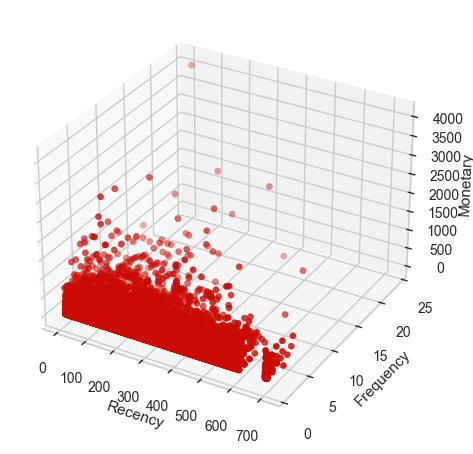

In [97]:
# Création du graphique 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(RFM['recency'], RFM['frequency'], RFM['monetary'], c='r', marker='o')

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')

plt.show()

In [98]:
print(RFM.isnull().sum())

customer_unique_id    0
recency               0
frequency             0
monetary              0
dtype: int64


Valeurs nulles dans le DataFrame :
A    True
B    True
C    True
dtype: bool

Nombre de valeurs nulles par colonne :
A    1
B    1
C    2
dtype: int64

Lignes contenant des valeurs nulles :
     A    B    C
0  1.0  NaN  1.0
1  2.0  2.0  NaN
2  NaN  3.0  NaN

Colonnes contenant des valeurs nulles :
Index(['A', 'B', 'C'], dtype='object')

Nombre de valeurs nulles par ligne :
0    1
1    1
2    2
dtype: int64


<Axes: >

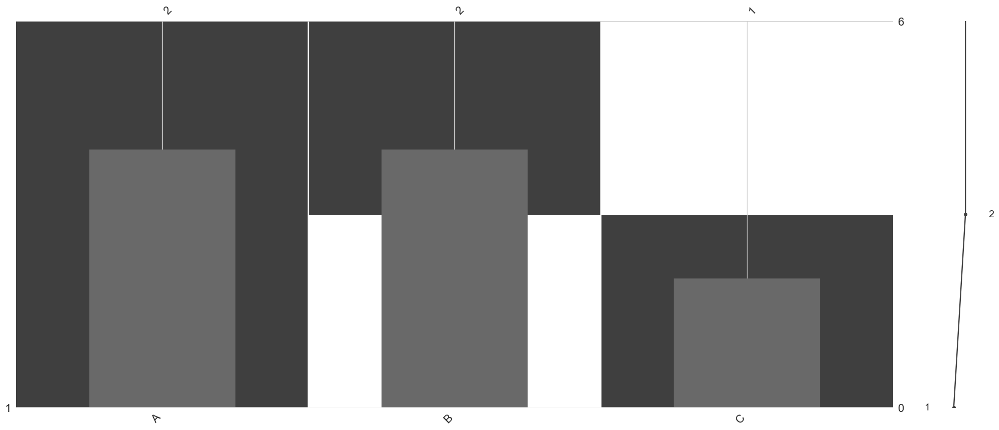

In [ ]:
import pandas as pd
import missingno as msno

# Exemple de création d'un DataFrame avec des valeurs nulles
data = {'A': [1, 2, None], 'B': [None, 2, 3], 'C': [1, None, None]}
df = pd.DataFrame(data)

# Afficher les valeurs nulles
print("Valeurs nulles dans le DataFrame :")
print(df.isnull().any())

# Afficher le nombre de valeurs nulles par colonne
print("\nNombre de valeurs nulles par colonne :")
print(df.isnull().sum())

# Afficher les lignes contenant des valeurs nulles
print("\nLignes contenant des valeurs nulles :")
print(df[df.isnull().any(axis=1)])

# Afficher les colonnes contenant des valeurs nulles
print("\nColonnes contenant des valeurs nulles :")
print(df.columns[df.isnull().any()])

# Afficher le nombre de valeurs nulles par ligne
null_values_per_row = df.isnull().sum(axis=1)
print("\nNombre de valeurs nulles par ligne :")
print(null_values_per_row) 

# Visualiser les valeurs nulles
msno.matrix(df)
msno.bar(df)

### Chargement des données

In [99]:
# Supposons que les colonnes R, F, M soient nommées 'Recency', 'Frequency', 'Monetary'
RFM = RFM[['recency', 'frequency', 'monetary']]

### Normalisation des données RFM

Normalisation des données pour assurer que chaque feature contribue de manière égale au clustering.


In [100]:
# Normalisation des données RFM
scaler = StandardScaler()
RFM_normalized = scaler.fit_transform(RFM)

### Détermination du nombre optimal de clusters `k`

Nous allons tester les valeurs de `k` de 2 à 15 et utiliser les métriques de silhouette et de distorsion (méthode du coude) pour déterminer les valeurs optimales de `k`.


In [101]:
# Fonction pour appliquer K-means et calculer les métriques
def kmeans_metrics(RFM_data, k_range):
    silhouette_scores = []
    distortions = []

    for k in k_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        labels = kmeans.fit_predict(RFM_data)
        silhouette_scores.append(silhouette_score(RFM_data, labels))
        distortions.append(kmeans.inertia_)

    return silhouette_scores, distortions

# Définir la plage de k (2 à 15)
k_range = range(2, 12)

# Calculer les métriques
silhouette_scores, distortions = kmeans_metrics(RFM_normalized, k_range)


### Visualisation des métriques

Nous allons visualiser les résultats pour identifier les valeurs optimales de `k` en utilisant le coefficient de silhouette et la méthode du coude.


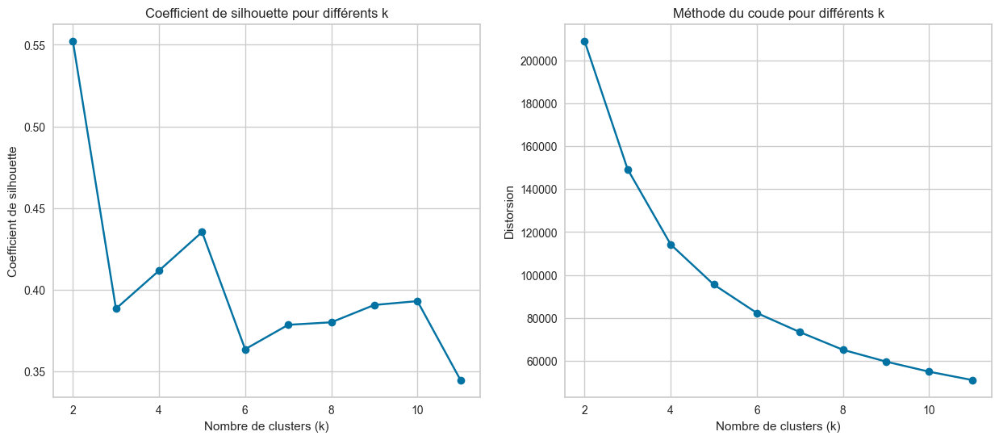

In [102]:
# Visualisation des résultats
fig, ax1 = plt.subplots(1, 2, figsize=(15, 6))

# Coefficient de silhouette
ax1[0].plot(k_range, silhouette_scores, marker='o')
ax1[0].set_xlabel('Nombre de clusters (k)')
ax1[0].set_ylabel('Coefficient de silhouette')
ax1[0].set_title('Coefficient de silhouette pour différents k')

# Méthode du coude (Distorsion)
ax1[1].plot(k_range, distortions, marker='o')
ax1[1].set_xlabel('Nombre de clusters (k)')
ax1[1].set_ylabel('Distorsion')
ax1[1].set_title('Méthode du coude pour différents k')

plt.show()

### Analyse des clusters pour les valeurs de `k` sélectionnées

En fonction des résultats des métriques, nous allons analyser les clusters pour les valeurs `k=4`,`k=5` et `k=6`.



Nombre de clients par cluster pour k=5:
Cluster_5
0    44600
1    32257
3     8718
2     5793
4      879
Name: count, dtype: int64


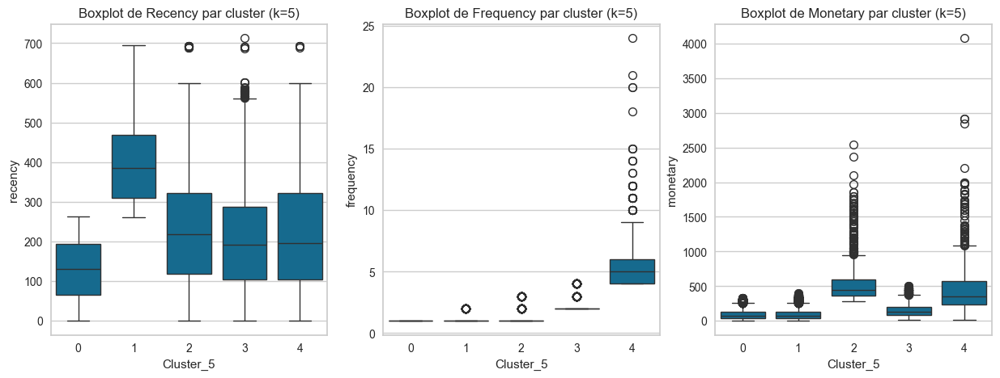


Moyennes par cluster pour k=5:
              recency  frequency    monetary
Cluster_5                                   
0          129.761883   1.000000   90.747421
1          395.065009   1.030567   92.570077
2          233.688762   1.196789  493.362341
3          203.075017   2.234228  147.721368
4          225.447099   5.411832  464.709784


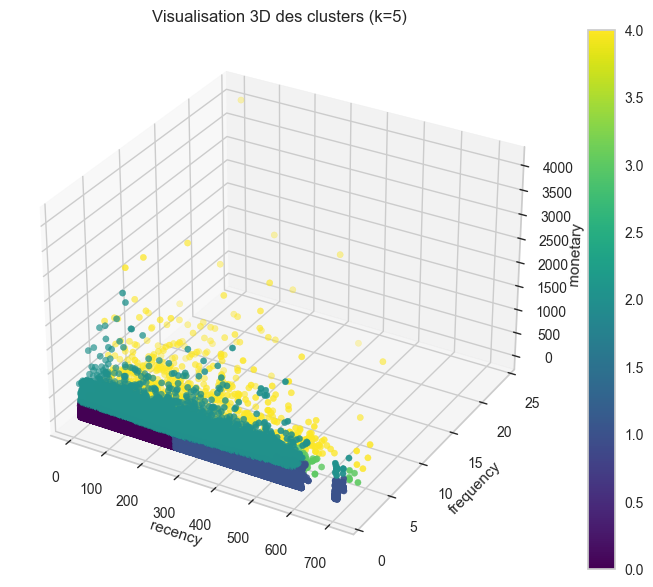


Nombre de clients par cluster pour k=6:
Cluster_6
3    29495
2    29026
0    18931
1     8637
5     5279
4      879
Name: count, dtype: int64


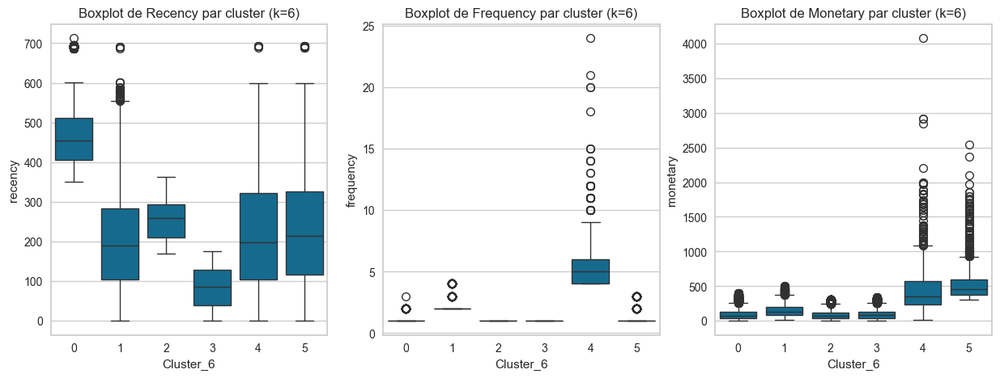


Moyennes par cluster pour k=6:
              recency  frequency    monetary  Cluster_5
Cluster_6                                              
0          461.705245   1.058159   96.783397   1.016164
1          200.124117   2.236309  148.044900   2.997221
2          255.674395   1.000000   89.934354   0.484462
3           86.162638   1.000000   93.673078   0.008612
4          225.758817   5.411832  464.691172   3.998862
5          231.729305   1.209699  510.527554   2.000000


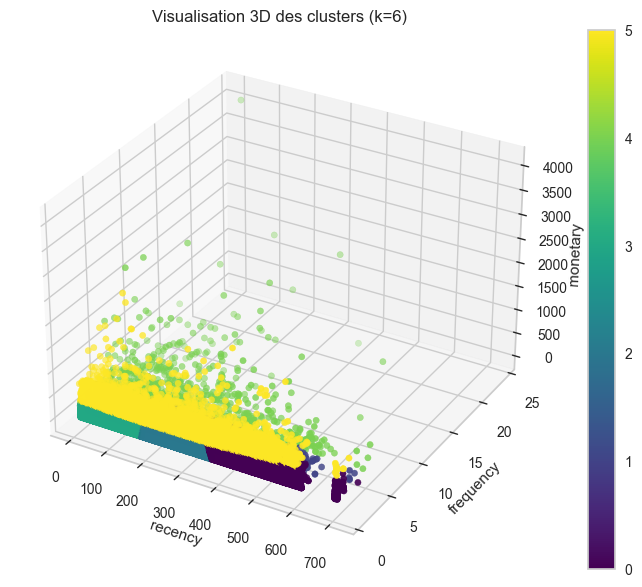

In [103]:
# Sélection des valeurs k candidates basées sur les analyses précédentes
k_candidates = [5, 6]

# Analyse plus approfondie des clusters pour les valeurs k candidates
for k in k_candidates:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    RFM[f'Cluster_{k}'] = kmeans.fit_predict(RFM_normalized)
    
    # Vérifier le nombre de clients par cluster
    print(f"\nNombre de clients par cluster pour k={k}:")
    print(RFM[f'Cluster_{k}'].value_counts())
    
    # Graphiques de boxplot par cluster
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    sns.boxplot(x=f'Cluster_{k}', y='recency', data=RFM)
    plt.title(f'Boxplot de Recency par cluster (k={k})')

    plt.subplot(1, 3, 2)
    sns.boxplot(x=f'Cluster_{k}', y='frequency', data=RFM)
    plt.title(f'Boxplot de Frequency par cluster (k={k})')

    plt.subplot(1, 3, 3)    
    sns.boxplot(x=f'Cluster_{k}', y='monetary', data=RFM)
    plt.title(f'Boxplot de Monetary par cluster (k={k})')

    plt.show()
    
    # Calcul des moyennes par cluster
    cluster_means = RFM.groupby(f'Cluster_{k}').mean()
    print(f"\nMoyennes par cluster pour k={k}:")
    print(cluster_means)

    # Graphiques 3D pour visualiser les clusters
    from mpl_toolkits.mplot3d import Axes3D
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(RFM['recency'], RFM['frequency'], RFM['monetary'], c=RFM[f'Cluster_{k}'], cmap='viridis')
    ax.set_xlabel('recency')
    ax.set_ylabel('frequency')
    ax.set_zlabel('monetary')
    ax.set_title(f'Visualisation 3D des clusters (k={k})')
    plt.colorbar(scatter)
    plt.show()



Nombre de clients par cluster pour k=3:
Cluster_3
1    48864
0    35958
2     7425
Name: count, dtype: int64


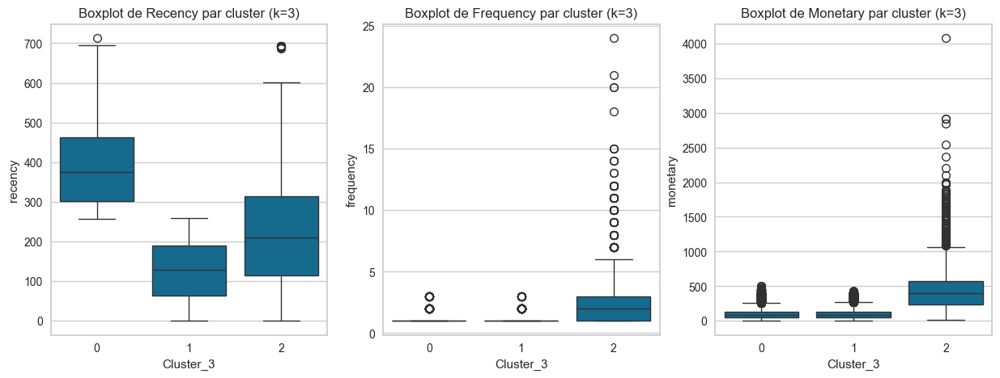


Moyennes par cluster pour k=3:
              recency  frequency    monetary  Cluster_5  Cluster_6
Cluster_3                                                         
0          388.236887   1.084015  100.217132   1.113243   0.954058
1          127.237926   1.078708   98.790974   0.285834   2.587815
2          225.690370   2.332929  425.158382   2.628418   3.276498


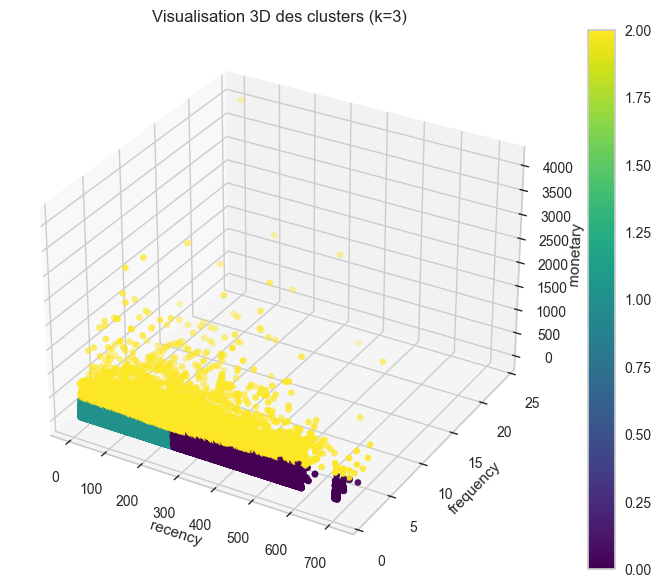


Nombre de clients par cluster pour k=4:
Cluster_4
0    47681
2    35072
1     6777
3     2717
Name: count, dtype: int64


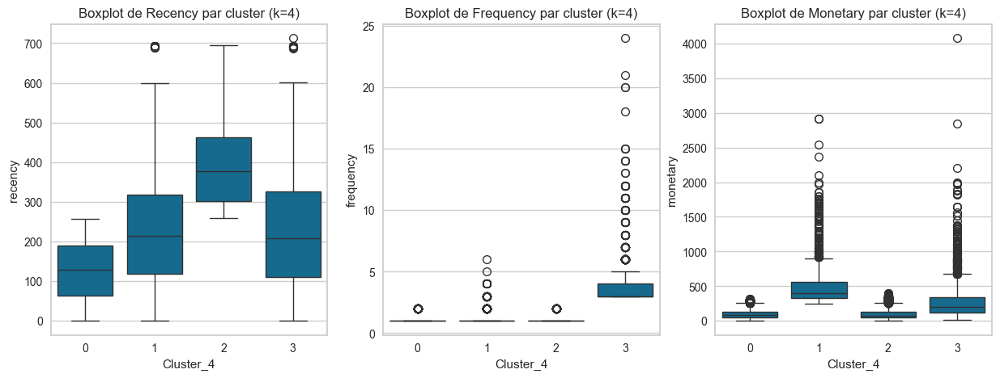


Moyennes par cluster pour k=4:
              recency  frequency    monetary  Cluster_5  Cluster_6  Cluster_3
Cluster_4                                                                    
0          127.058157   1.088211   92.610634   0.264634   2.523710   1.008620
1          229.865427   1.241405  465.231415   1.997492   4.198465   1.453741
2          388.191549   1.088333   93.303615   1.095746   0.872919   0.014342
3          229.155318   3.879647  274.841918   3.285977   2.092013   1.938535


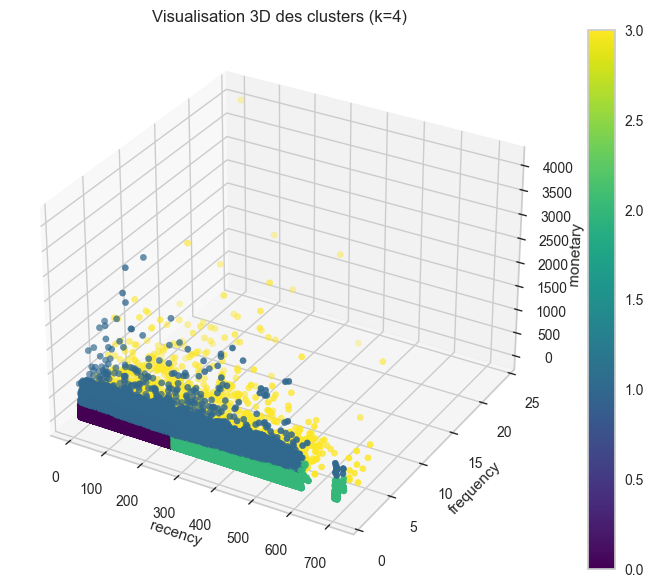

In [104]:
# Sélection des valeurs k candidates basées sur les analyses précédentes
k_candidates = [3, 4]

# Analyse plus approfondie des clusters pour les valeurs k candidates
for k in k_candidates:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    RFM[f'Cluster_{k}'] = kmeans.fit_predict(RFM_normalized)
    
    # Vérifier le nombre de clients par cluster
    print(f"\nNombre de clients par cluster pour k={k}:")
    print(RFM[f'Cluster_{k}'].value_counts())
    
    # Graphiques de boxplot par cluster
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    sns.boxplot(x=f'Cluster_{k}', y='recency', data=RFM)
    plt.title(f'Boxplot de Recency par cluster (k={k})')

    plt.subplot(1, 3, 2)
    sns.boxplot(x=f'Cluster_{k}', y='frequency', data=RFM)
    plt.title(f'Boxplot de Frequency par cluster (k={k})')

    plt.subplot(1, 3, 3)    
    sns.boxplot(x=f'Cluster_{k}', y='monetary', data=RFM)
    plt.title(f'Boxplot de Monetary par cluster (k={k})')

    plt.show()
    
    # Calcul des moyennes par cluster
    cluster_means = RFM.groupby(f'Cluster_{k}').mean()
    print(f"\nMoyennes par cluster pour k={k}:")
    print(cluster_means)

    # Graphiques 3D pour visualiser les clusters
    from mpl_toolkits.mplot3d import Axes3D
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(RFM['recency'], RFM['frequency'], RFM['monetary'], c=RFM[f'Cluster_{k}'], cmap='viridis')
    ax.set_xlabel('recency')
    ax.set_ylabel('frequency')
    ax.set_zlabel('monetary')
    ax.set_title(f'Visualisation 3D des clusters (k={k})')
    plt.colorbar(scatter)
    plt.show()


## Conclusion

Cette analyse permet de déterminer les valeurs optimales de `k` pour le clustering K-means en utilisant les features RFM. Les valeurs de `k=4` et `k=5` semblent pertinentes d'un point de vue métier. L'analyse détaillée des clusters montre des typologies de clients distinctes et exploitables pour des actions marketing ciblées.


# Analyse et comparaison avec différents algorithmes de clustering

Nous allons comparer les résultats de K-means avec ceux de DBSCAN et Agglomerative Clustering.

In [105]:
# Importation des bibliothèques nécessaires
from sklearn.cluster import DBSCAN, AgglomerativeClustering
from sklearn.metrics import silhouette_score, calinski_harabasz_score

# Pour Agglomerative Clustering, nous pouvons utiliser un sous-échantillon si le temps de traitement est trop long
from sklearn.utils import resample


### Chargement et normalisation des données RFM

Les donneés sont déja chargées et normalisées.

In [106]:
# Supposons que les colonnes R, F, M soient nommées 'Recency', 'Frequency', 'Monetary'
RFM = RFM[['recency', 'frequency', 'monetary']]

# Normalisation des données RFM
scaler = StandardScaler()
RFM_normalized = scaler.fit_transform(RFM)

## Test de l'algorithme DBSCAN

Nous allons faire varier l'hyper-paramètre `eps` et observer les résultats avec `min_samples` fixé à 100 puis à 10.

In [107]:
# Test DBSCAN avec min_samples=100
eps_values = np.arange(0.1, 2.0, 0.1)
min_samples = 100

for eps in eps_values:
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    labels = dbscan.fit_predict(RFM_normalized)
    
    # Vérifier le nombre de clusters et le nombre de clients dans le cluster -1 (bruit)
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
    noise_points = list(labels).count(-1)
    
    print(f"DBSCAN avec eps={eps:.1f}, min_samples={min_samples}:")
    print(f"Nombre de clusters: {n_clusters}")
    print(f"Nombre de clients dans le cluster -1 (bruit): {noise_points}\n")

DBSCAN avec eps=0.1, min_samples=100:
Nombre de clusters: 4
Nombre de clients dans le cluster -1 (bruit): 19541

DBSCAN avec eps=0.2, min_samples=100:
Nombre de clusters: 2
Nombre de clients dans le cluster -1 (bruit): 8127

DBSCAN avec eps=0.3, min_samples=100:
Nombre de clusters: 5
Nombre de clients dans le cluster -1 (bruit): 4639

DBSCAN avec eps=0.4, min_samples=100:
Nombre de clusters: 5
Nombre de clients dans le cluster -1 (bruit): 2811

DBSCAN avec eps=0.5, min_samples=100:
Nombre de clusters: 4
Nombre de clients dans le cluster -1 (bruit): 2182

DBSCAN avec eps=0.6, min_samples=100:
Nombre de clusters: 3
Nombre de clients dans le cluster -1 (bruit): 1799



### Conclusion sur DBSCAN

L'algorithme DBSCAN ne semble pas approprié pour nos données car il ne produit pas un nombre de clusters intéressant ou laisse trop de clients sans cluster.


## Test de l'algorithme Agglomerative Clustering

Nous allons comparer les résultats d'Agglomerative Clustering avec ceux de K-means.


In [ ]:
# Test Agglomerative Clustering
k_candidates = [4, 5]

# Pour éviter les temps de traitement longs, nous pouvons utiliser un échantillon
sample_size = 20000
RFM_sample = resample(RFM_normalized, n_samples=sample_size, random_state=42)

# Stockage des labels pour visualisation plus tard
agg_labels_dict = {}

for k in k_candidates:
    agg_clustering = AgglomerativeClustering(n_clusters=k)
    labels = agg_clustering.fit_predict(RFM_sample)
    agg_labels_dict[k] = labels
    
    # Calcul des métriques pour comparaison
    silhouette_avg = silhouette_score(RFM_sample, labels)
    ch_score = calinski_harabasz_score(RFM_sample, labels)
    
    print(f"Agglomerative Clustering avec k={k}:")
    print(f"Coefficient de silhouette: {silhouette_avg:.3f}")
    print(f"Indice de Calinski-Harabasz: {ch_score:.3f}\n")


Agglomerative Clustering avec k=4:
Coefficient de silhouette: 0.377
Indice de Calinski-Harabasz: 10675.036

Agglomerative Clustering avec k=5:
Coefficient de silhouette: 0.378
Indice de Calinski-Harabasz: 11086.409



### Conclusion sur Agglomerative Clustering

Les résultats d'Agglomerative Clustering sont assez similaires à ceux de K-means en termes de coefficient de silhouette et d'indice de Calinski-Harabasz, mais les temps de traitement peuvent être plus longs.


## Visualisation et analyse des clusters

Pour visualiser et analyser les clusters, nous allons nous concentrer sur les résultats de K-means et Agglomerative Clustering.


c:\Users\Mathieu Bosse\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


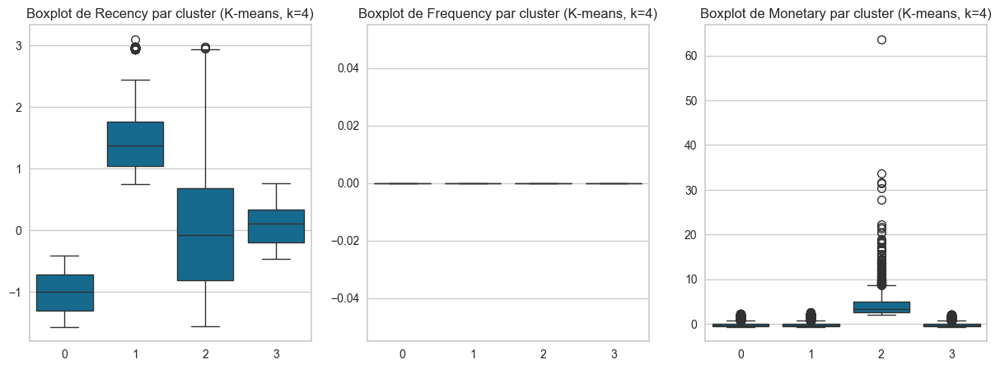

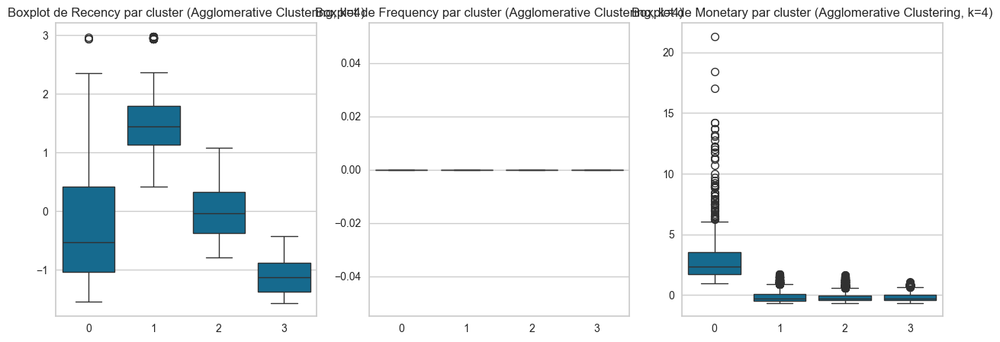

In [ ]:
# Fonction pour visualiser les clusters
def plot_clusters(data, labels, algorithm_name, k):
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 3, 1)
    sns.boxplot(x=labels, y=data[:, 0])
    plt.title(f'Boxplot de Recency par cluster ({algorithm_name}, k={k})')

    plt.subplot(1, 3, 2)
    sns.boxplot(x=labels, y=data[:, 1])
    plt.title(f'Boxplot de Frequency par cluster ({algorithm_name}, k={k})')

    plt.subplot(1, 3, 3)
    sns.boxplot(x=labels, y=data[:, 2])
    plt.title(f'Boxplot de Monetary par cluster ({algorithm_name}, k={k})')
    
    plt.show()

# Visualisation pour K-means avec k=4 (par exemple)
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans_labels = kmeans.fit_predict(RFM_normalized)
plot_clusters(RFM_normalized, kmeans_labels, "K-means", 4)

# Visualisation pour Agglomerative Clustering avec k=4 en utilisant les labels du modèle échantillonné
agg_labels_sampled = agg_labels_dict[4]  # Labels from Agglomerative Clustering with k=4 on the sampled data
plot_clusters(RFM_sample, agg_labels_sampled, "Agglomerative Clustering", 4)

## Conclusion générale

En conclusion, K-means et Agglomerative Clustering produisent des résultats similaires en termes de qualité des clusters, tandis que DBSCAN n'est pas adapté pour ces données. K-means reste une bonne option en raison de sa simplicité et de sa rapidité.


# Analyse des clusters K-means avec les features RFM et une variable supplémentaire

Dans cette analyse, nous utiliserons l'algorithme de clustering K-means pour segmenter nos clients en fonction des features RFM (Recency, Frequency, Monetary) ainsi qu'une autre feature numérique, le score d'avis client (`review_score`). Nous ajouterons ensuite une colonne catégorielle pour enrichir notre analyse de segmentation.

1. **RFM Features** :
   - **Recency** : Nombre de jours depuis la dernière commande.
   - **Frequency** : Nombre de commandes passées.
   - **Monetary** : Montant total dépensé.

2. **Score d'avis client** :
   - **Review Score** : Moyenne des scores d'avis donnés par chaque client.

3. **Colonne catégorielle** : `customer_state`
   - Nous utiliserons la colonne `customer_state` pour approfondir l'analyse.

Nous allons commencer par préparer nos données et effectuer le clustering K-means avec les features RFM (recency, frequency, monetary) et la variable catégorielle `customer_state`. Ensuite, nous examinerons les clusters résultants pour comprendre les segments de clients.


## RFM et customer_state

### Fusion des DataFrames RFM et customer_state :

In [3]:
# Charger le DataFrame RFM à partir du fichier CSV
RFM = pd.read_csv('rfm_python.csv')

customer_state_df = pd.read_csv('customer_state_df.csv')

In [4]:
# Fusionner RFM avec customer_state_df sur 'customer_id' en utilisant une jointure gauche et en sélectionnant la première occurrence de chaque customer_id
rfm_with_customer_state = pd.merge(RFM, customer_state_df, on="customer_unique_id", how="left")

# Afficher les premières lignes du DataFrame fusionné
display(rfm_with_customer_state.head())


,customer_unique_id,recency,frequency,monetary,customer_state
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,129.90,SP
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,18.90,SP
2,0000f46a3911fa3c0805444483337064,536,1,69.00,SC
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,25.99,PA
4,0004aac84e0df4da2b147fca70cf8255,287,1,180.00,SP


In [6]:
print(rfm_with_customer_state.isnull().sum())

customer_unique_id    0
recency               0
frequency             0
monetary              0
customer_state        0
dtype: int64


In [7]:
rfm_with_customer_state.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92247 entries, 0 to 92246
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_unique_id  92247 non-null  object 
 1   recency             92247 non-null  int64  
 2   frequency           92247 non-null  int64  
 3   monetary            92247 non-null  float64
 4   customer_state      92247 non-null  object 
dtypes: float64(1), int64(2), object(2)
memory usage: 3.5+ MB


In [8]:
# Appliquer l'encodage one-hot à la colonne customer_state
RFM_customer_state_encoded = pd.get_dummies(rfm_with_customer_state, columns=['customer_state'], prefix='state')

# Afficher les premières lignes du DataFrame avec l'encodage one-hot
print(RFM_customer_state_encoded.head())

                 customer_unique_id  recency  frequency  monetary  state_AC  \
0  0000366f3b9a7992bf8c76cfdf3221e2      111          1    129.90     False   
1  0000b849f77a49e4a4ce2b2a4ca5be3f      114          1     18.90     False   
2  0000f46a3911fa3c0805444483337064      536          1     69.00     False   
3  0000f6ccb0745a6a4b88665a16c9f078      320          1     25.99     False   
4  0004aac84e0df4da2b147fca70cf8255      287          1    180.00     False   

   state_AL  state_AM  state_AP  state_BA  state_CE  ...  state_PR  state_RJ  \
0     False     False     False     False     False  ...     False     False   
1     False     False     False     False     False  ...     False     False   
2     False     False     False     False     False  ...     False     False   
3     False     False     False     False     False  ...     False     False   
4     False     False     False     False     False  ...     False     False   

   state_RN  state_RO  state_RR  state_RS  s

In [9]:
# Sélectionner les colonnes pour l'analyse K-means (recency, frequency, monetary, et toutes les colonnes one-hot)
columns_for_kmeans = ['recency', 'frequency', 'monetary'] + list(RFM_customer_state_encoded.columns[RFM_customer_state_encoded.columns.str.startswith('state_')])

# Sélectionner les données pour K-means
data_for_kmeans = RFM_customer_state_encoded[columns_for_kmeans]

# Standardiser les données
scaler = StandardScaler()
RFM_customer_state_encoded_normalized = scaler.fit_transform(data_for_kmeans)

# Afficher les premières lignes des données normalisées
print(RFM_customer_state_encoded_normalized[:5])


[[-0.82534584 -0.29168534  0.03152046 -0.0283344  -0.06363159 -0.0385662
  -0.02634903 -0.18691323 -0.11644098 -0.14844806 -0.14540651 -0.14404019
  -0.08687516 -0.36527061 -0.08495446 -0.09574752 -0.09864557 -0.07277615
  -0.1298246  -0.07040496 -0.23190891 -0.3822441  -0.07032717 -0.04900505
  -0.02056591 -0.24203831 -0.1956819  -0.05900019  1.17364336 -0.05316471]
 [-0.80567917 -0.29168534 -0.78525163 -0.0283344  -0.06363159 -0.0385662
  -0.02634903 -0.18691323 -0.11644098 -0.14844806 -0.14540651 -0.14404019
  -0.08687516 -0.36527061 -0.08495446 -0.09574752 -0.09864557 -0.07277615
  -0.1298246  -0.07040496 -0.23190891 -0.3822441  -0.07032717 -0.04900505
  -0.02056591 -0.24203831 -0.1956819  -0.05900019  1.17364336 -0.05316471]
 [ 1.96076694 -0.29168534 -0.41660044 -0.0283344  -0.06363159 -0.0385662
  -0.02634903 -0.18691323 -0.11644098 -0.14844806 -0.14540651 -0.14404019
  -0.08687516 -0.36527061 -0.08495446 -0.09574752 -0.09864557 -0.07277615
  -0.1298246  -0.07040496 -0.23190891 -

In [10]:
# Fonction pour appliquer K-means et calculer les métriques
def kmeans_metrics(RFM_data, k_range):
    silhouette_scores = []
    distortions = []

    for k in k_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        labels = kmeans.fit_predict(RFM_data)
        silhouette_scores.append(silhouette_score(RFM_data, labels))
        distortions.append(kmeans.inertia_)

    return silhouette_scores, distortions

# Définir la plage de k (2 à 7)
k_range = range(2, 7)

# Calculer les métriques
silhouette_scores, distortions = kmeans_metrics(RFM_customer_state_encoded_normalized, k_range)

# Afficher les scores de silhouette et les distorsions
print("Silhouette Scores:", silhouette_scores)
print("Distortions:", distortions)


Silhouette Scores: [0.011420302761356714, 0.08322287781504095, 0.20488361507256492, 0.16824314478582386, 0.169176202726133]
Distortions: [2658861.8465160327, 2550729.572438945, 2442829.6055943603, 2354885.0891779424, 2262942.387911903]


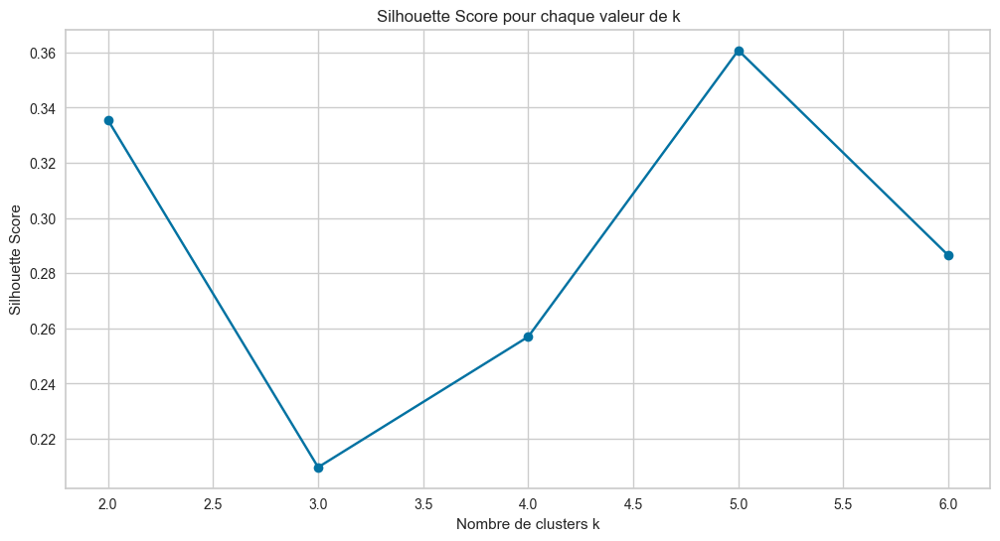

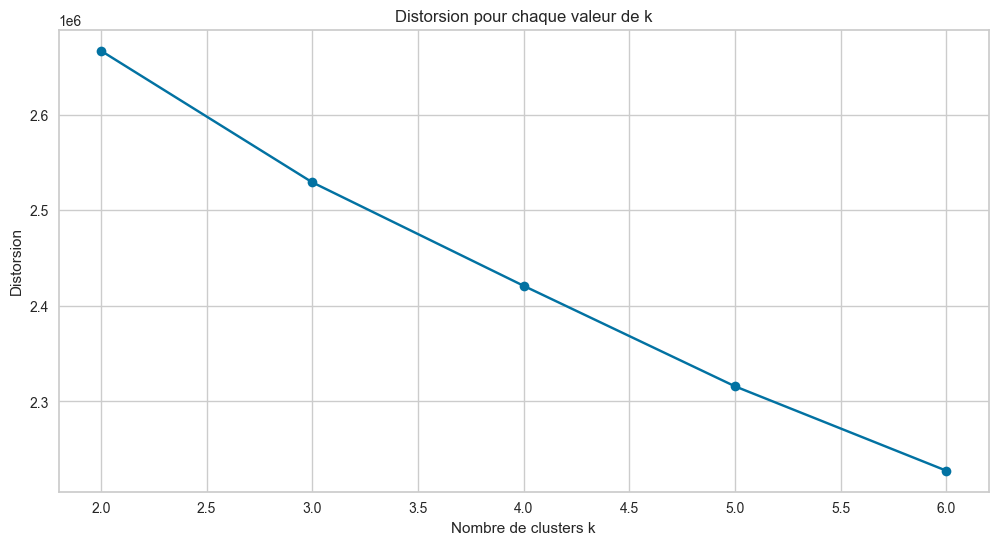

In [ ]:
# Visualisation des scores de silhouette
plt.figure(figsize=(12, 6))
plt.plot(k_range, silhouette_scores, marker='o')
plt.title('Silhouette Score pour chaque valeur de k')
plt.xlabel('Nombre de clusters k')
plt.ylabel('Silhouette Score')
plt.show()

# Visualisation des distorsions
plt.figure(figsize=(12, 6))
plt.plot(k_range, distortions, marker='o')
plt.title('Distorsion pour chaque valeur de k')
plt.xlabel('Nombre de clusters k')
plt.ylabel('Distorsion')
plt.show()

In [11]:
# Choisir la meilleure valeur de k (par exemple, en se basant sur le score de silhouette maximum)
best_k = k_range[silhouette_scores.index(max(silhouette_scores))]
print(f"La meilleure valeur de k basée sur le score de silhouette maximum est : {best_k}")

# Appliquer K-means avec la meilleure valeur de k
kmeans = KMeans(n_clusters=best_k, random_state=42, n_init=10)
rfm_with_customer_state['cluster'] = kmeans.fit_predict(RFM_customer_state_encoded_normalized)

# Afficher les premières lignes du DataFrame avec les clusters
display(rfm_with_customer_state.head())


La meilleure valeur de k basée sur le score de silhouette maximum est : 4


,customer_unique_id,recency,frequency,monetary,customer_state,cluster
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,129.90,SP,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,18.90,SP,0
2,0000f46a3911fa3c0805444483337064,536,1,69.00,SC,3
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,25.99,PA,2
4,0004aac84e0df4da2b147fca70cf8255,287,1,180.00,SP,0


In [13]:
# Analyse des clusters
cluster_analysis = rfm_with_customer_state.groupby('cluster').agg({
    'recency': 'mean',
    'frequency': 'mean',
    'monetary': 'mean',
    'customer_unique_id': 'count'
}).reset_index()

# Renommer la colonne 'customer_id' en 'count'
cluster_analysis.rename(columns={'customer_id': 'count'}, inplace=True)

# Afficher l'analyse des clusters
print(cluster_analysis)


   cluster     recency  frequency    monetary  customer_unique_id
0        0  226.344938   1.187444  117.521037               38865
1        1  236.603009   1.130804  145.064552                1529
2        2  244.746404   1.178139  131.277307               48451
3        3  245.872134   1.190476  128.734618                3402


### Visualisation des clusters K-means en 3D

Après avoir appliqué l'algorithme K-means pour segmenter nos clients en fonction des features RFM et du score d'avis client, nous allons visualiser les résultats en trois dimensions. Pour ce faire, nous utilisons t-SNE pour réduire les dimensions à un espace 3D et Plotly pour créer des graphiques interactifs.

Les visualisations nous permettront d'observer la distribution et la séparation des clusters, facilitant ainsi l'interprétation des segments de clients identifiés.


In [14]:
# Visualisation 3D des clusters en utilisant recency, frequency, et monetary
fig = px.scatter_3d(
    rfm_with_customer_state, x='recency', y='frequency', z='monetary',
    color='cluster',
    title='Visualisation 3D des clusters K-means avec recency, frequency, et monetary',
    opacity=0.7,
    color_continuous_scale=px.colors.sequential.Viridis
)
fig.show()

In [15]:
# Visualisation 3D des clusters en utilisant recency, frequency, et monetary
fig = px.scatter_3d(
    rfm_with_customer_state, x='recency', y='monetary', z='customer_state',
    color='cluster',
    title='Visualisation 3D des clusters K-means avec recency, frequency, et monetary',
    opacity=0.7,
    color_continuous_scale=px.colors.sequential.Viridis
)
fig.show()

## RFM et review_score

### Fusion des DataFrames RFM et review_score :

In [ ]:
# Charger le DataFrame RFM à partir du fichier CSV
RFM = pd.read_csv('rfm_python.csv')

In [20]:
# Fusionner le DataFrame rfm avec average_review_scores_df sur 'customer_id'
rfm_with_reviews = pd.merge(RFM, average_review_scores_df, how='left', on='customer_unique_id')

# Afficher les premières lignes du DataFrame fusionné
display(rfm_with_reviews.head())


,customer_unique_id,recency,frequency,monetary,review_score
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,129.90,5.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,18.90,4.0
2,0000f46a3911fa3c0805444483337064,536,1,69.00,3.0
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,25.99,4.0
4,0004aac84e0df4da2b147fca70cf8255,287,1,180.00,5.0


Vérification des Valeurs Nulles dans `rfm_with_reviews`

In [21]:
print(rfm_with_reviews.isnull().sum())

customer_unique_id      0
recency                 0
frequency               0
monetary                0
review_score          587
dtype: int64


- `customer_id`, `recency`, `frequency`, `monetary`: Aucune valeur nulle, données complètes pour tous les clients.
- `average_review_score`: 587 valeurs nulles, indiquant que certains clients n'ont pas de score moyen d'avis enregistré.


### Préparation des Données pour l'Analyse

Pour garantir la qualité des données :

- **Remplissage des valeurs manquantes** : Les valeurs nulles dans `average_review_score` ont été remplacées par la moyenne des scores.
- **Normalisation des Données RFM et review_score** : Les colonnes `recency`, `frequency`, `monetary`, et `average_review_score` ont été normalisées à l'aide de `StandardScaler`.


In [23]:
# Remplir les valeurs manquantes dans 'average_review_score' par la moyenne des scores
rfm_with_reviews['review_score'].fillna(rfm_with_reviews['review_score'].mean(), inplace=True)

# Normalisation des données RFM et review_score
features = ['recency', 'frequency', 'monetary', 'review_score']
scaler = StandardScaler()
RFM_reviews_normalized = scaler.fit_transform(rfm_with_reviews[features])

# Afficher les premières lignes des données normalisées
print(RFM_reviews_normalized[:5])


[[-0.82534584 -0.29168534  0.03152046  0.6639949 ]
 [-0.80567917 -0.29168534 -0.78525163 -0.12032727]
 [ 1.96076694 -0.29168534 -0.41660044 -0.90464945]
 [ 0.54476609 -0.29168534 -0.73308123 -0.12032727]
 [ 0.32843263 -0.29168534  0.40017165  0.6639949 ]]


### Application de K-means pour l'Analyse de Segmentation

Cette cellule de code utilise l'algorithme K-means pour segmenter les clients en clusters basés sur les données normalisées RFM et `average_review_score`.

- **Objectif** : Appliquer K-means pour identifier des groupes de clients similaires.
- **Méthode** : La fonction `kmeans_metrics` est utilisée pour calculer les scores de silhouette et les distorsions pour différentes valeurs de k.

In [24]:
# Fonction pour appliquer K-means et calculer les métriques
def kmeans_metrics(RFM_data, k_range):
    silhouette_scores = []
    distortions = []

    for k in k_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        labels = kmeans.fit_predict(RFM_data)
        silhouette_scores.append(silhouette_score(RFM_data, labels))
        distortions.append(kmeans.inertia_)

    return silhouette_scores, distortions

# Définir la plage de k (2 à 12)
k_range = range(2, 12)

# Calculer les métriques
silhouette_scores, distortions = kmeans_metrics(RFM_reviews_normalized, k_range)

# Afficher les scores de silhouette et les distorsions
print("Silhouette Scores:", silhouette_scores)
print("Distortions:", distortions)


Silhouette Scores: [0.4297402178686002, 0.36917872787767886, 0.3370300408770603, 0.355882430170252, 0.3648234157706999, 0.2917480836524767, 0.2945760102902313, 0.2992664993978801, 0.29794914006887074, 0.3069833430721065]
Distortions: [293185.66381474736, 234783.43863417086, 182681.1954548938, 148741.96326692385, 133644.29401698586, 122545.238854052, 114215.04589336195, 106175.4517182168, 99499.2775728611, 92067.66423642887]


### Visualisation des Scores de Silhouette et des Distorsions

Ces graphiques illustrent les performances de l'algorithme K-means pour différentes valeurs de k, appliqué aux données normalisées RFM et `average_review_score`.

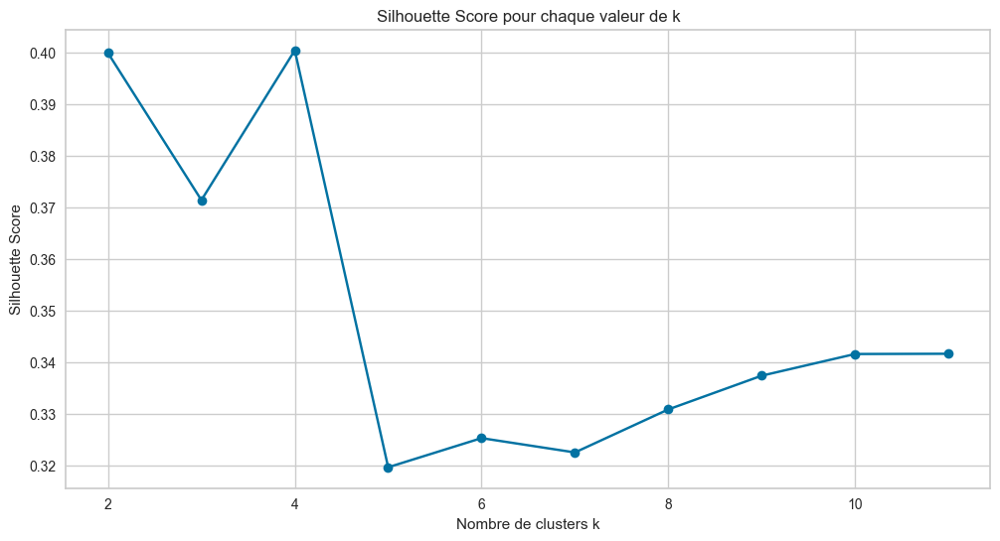

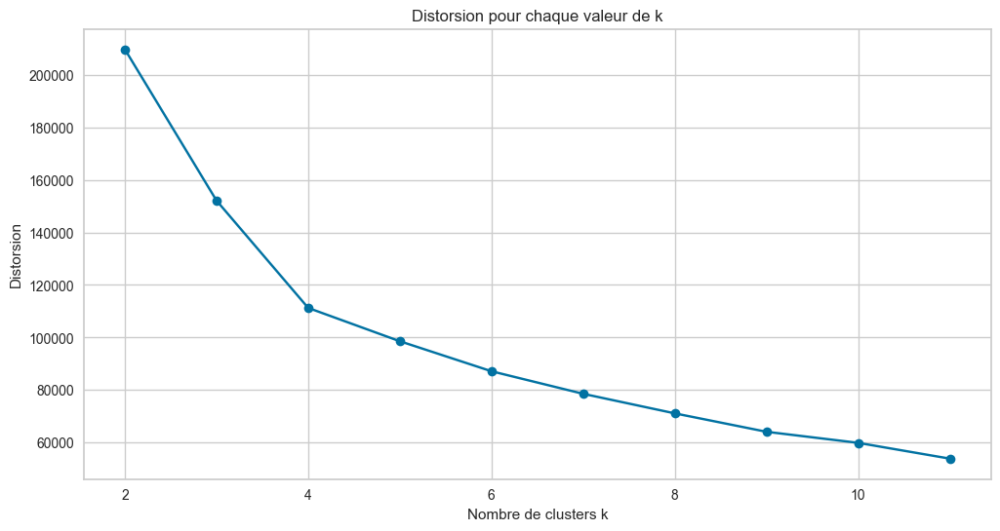

In [ ]:
# Visualisation des scores de silhouette
plt.figure(figsize=(12, 6))
plt.plot(k_range, silhouette_scores, marker='o')
plt.title('Silhouette Score pour chaque valeur de k')
plt.xlabel('Nombre de clusters k')
plt.ylabel('Silhouette Score')
plt.show()

# Visualisation des distorsions
plt.figure(figsize=(12, 6))
plt.plot(k_range, distortions, marker='o')
plt.title('Distorsion pour chaque valeur de k')
plt.xlabel('Nombre de clusters k')
plt.ylabel('Distorsion')
plt.show()

*Interprétation des Graphiques pour le Choix du Nombre de Clusters*

Les graphiques ci-dessus aident à déterminer le nombre optimal de clusters (k) pour la segmentation des clients à partir des données RFM et `average_review_score`.

**Scores de Silhouette**

Le score de silhouette mesure à quel point chaque point de données est similaire aux points de son propre cluster par rapport aux autres clusters. Un score plus élevé (proche de 1) indique une bonne séparation entre les clusters.

- Les scores de silhouette augmentent jusqu'à k=4, ce qui suggère une bonne séparation des clusters à ce nombre.
- Au-delà de k=4, les scores de silhouette commencent à diminuer légèrement, indiquant une moins bonne séparation entre les clusters.

**Distorsions**

La distorsion représente la somme des carrés des distances des échantillons à leur centre de cluster le plus proche. Elle diminue généralement à mesure que le nombre de clusters augmente.

- La distorsion diminue significativement jusqu'à k=4, ce qui montre que chaque cluster est compact et bien défini.
- Après k=4, la diminution de la distorsion ralentit, indiquant des gains marginaux en variance expliquée avec chaque cluster supplémentaire.

**Conclusion**

En combinant ces analyses :
- Scores de Silhouette et Distorsions : k=4 semble être un compromis optimal entre la séparation des clusters et la variance expliquée des données.
- Choix de k=4 : Il semble approprié pour segmenter efficacement les clients tout en maintenant la cohérence et la pertinence des clusters.


### Application de K-means avec la Meilleure Valeur de k

Après avoir sélectionné la meilleure valeur de k basée sur le score de silhouette maximum, nous appliquons maintenant l'algorithme K-means aux données RFM et `average_review_score`. Cela nous permet de segmenter les clients en clusters distincts, facilitant ainsi une meilleure compréhension et une action ciblée pour l'équipe marketing d'Olist.

In [ ]:
# Choisir la meilleure valeur de k (par exemple, en se basant sur le score de silhouette maximum)
best_k = k_range[silhouette_scores.index(max(silhouette_scores))]
print(f"La meilleure valeur de k basée sur le score de silhouette maximum est : {best_k}")

# Appliquer K-means avec la meilleure valeur de k
kmeans = KMeans(n_clusters=best_k, random_state=42, n_init=10)
rfm_with_reviews['cluster'] = kmeans.fit_predict(RFM_reviews_normalized)

# Afficher les premières lignes du DataFrame avec les clusters
display(rfm_with_reviews.head())


La meilleure valeur de k basée sur le score de silhouette maximum est : 4


,customer_id,recency,frequency,monetary,average_review_score,cluster
0,00012a2ce6f8dcda20d059ce98491703,2435,1,89.80,1.0,3
1,000161a058600d5901f007fab4c27140,2556,1,54.90,4.0,2
2,0001fd6190edaaf884bcaf3d49edf079,2694,1,179.99,5.0,2
3,0002414f95344307404f0ace7a26f1d5,2525,1,149.90,5.0,2
4,000379cdec625522490c315e70c7a9fb,2296,1,93.00,4.0,1


### Analyse des clusters

Nous avons effectué une analyse des clusters à partir des données RFM et `average_review_score`. Cette analyse permet de comprendre les caractéristiques moyennes de chaque cluster de clients identifiés par l'algorithme K-means.

Les principales métriques analysées sont :
- **Recency** : La moyenne de la période écoulée depuis la dernière commande.
- **Frequency** : La moyenne du nombre de commandes par client.
- **Monetary** : La moyenne des dépenses totales par client.
- **Average Review Score** : La moyenne des scores d'évaluation donnés par les clients.
- **Nombre de Clients (Count)** : Le nombre de clients attribués à chaque cluster.

Cela nous permet de mieux comprendre comment les clients sont regroupés selon leur comportement d'achat et leurs évaluations, facilitant ainsi des stratégies marketing et d'engagement plus ciblées.

In [ ]:
# Analyse des clusters
cluster_analysis = rfm_with_reviews.groupby('cluster').agg({
    'recency': 'mean',
    'frequency': 'mean',
    'monetary': 'mean',
    'review_score': 'mean',
    'customer_unique_id': 'count'
}).reset_index()

# Renommer la colonne 'customer_id' en 'count'
cluster_analysis.rename(columns={'customer_unique_id': 'count'}, inplace=True)

# Afficher l'analyse des clusters
print(cluster_analysis)


   cluster      recency  frequency    monetary  average_review_score  count
0        0  2388.098889        1.0  619.394704              4.201463   4409
1        1  2270.580457        1.0  100.417991              4.702475  42439
2        2  2541.677073        1.0  101.747127              4.636921  32481
3        3  2379.139083        1.0  115.559019              1.725643  16012


- **Cluster 0** :
  - Recency moyenne : 2388 jours
  - Frequency moyenne : 1.0
  - Montant moyen des dépenses (Monetary) : 619.39 unités monétaires
  - Score moyen d'évaluation (Average Review Score) : 4.20
  - Nombre de clients : 4409

- **Cluster 1** :
  - Recency moyenne : 2270 jours
  - Frequency moyenne : 1.0
  - Montant moyen des dépenses (Monetary) : 100.42 unités monétaires
  - Score moyen d'évaluation (Average Review Score) : 4.70
  - Nombre de clients : 42439

- **Cluster 2** :
  - Recency moyenne : 2541 jours
  - Frequency moyenne : 1.0
  - Montant moyen des dépenses (Monetary) : 101.75 unités monétaires
  - Score moyen d'évaluation (Average Review Score) : 4.64
  - Nombre de clients : 32481

- **Cluster 3** :
  - Recency moyenne : 2379 jours
  - Frequency moyenne : 1.0
  - Montant moyen des dépenses (Monetary) : 115.56 unités monétaires
  - Score moyen d'évaluation (Average Review Score) : 1.73
  - Nombre de clients : 16012

Cette analyse résume les caractéristiques distinctives de chaque cluster en termes de comportement d'achat, de satisfaction client et de récence des commandes.


### Visualisation des clusters K-means en 3D

Voici une visualisation 3D des clusters K-means en utilisant les variables recency, frequency, et monetary. Chaque point représente un client, coloré selon son cluster attribué par l'algorithme K-means. Cette visualisation permet de voir la répartition des clients en fonction de leur comportement d'achat et de leur valeur monétaire.

In [ ]:
# Visualisation 3D des clusters en utilisant recency, frequency, et monetary
fig = px.scatter_3d(
    rfm_with_reviews, x='recency', y='frequency', z='monetary',
    color='cluster',
    title='Visualisation 3D des clusters K-means avec recency, frequency, et monetary',
    opacity=0.7,
    color_continuous_scale=px.colors.sequential.Viridis
)
fig.show()

Les clusters identifiés ne montrent pas une distinction claire, suggérant que les données RFM et average_review_score ne sont pas très pertinentes pour une segmentation efficace des clients. Cela peut indiquer que les données disponibles ne sont pas adaptées ou qu'une approche différente de segmentation pourrait être nécessaire pour mieux comprendre les différents types de clients.

In [ ]:
# Visualisation 3D des clusters en utilisant recency, frequency, et monetary
fig = px.scatter_3d(
    rfm_with_reviews, x='recency', y='monetary', z='review_score',
    color='cluster',
    title='Visualisation 3D des clusters K-means avec recency, frequency, et monetary',
    opacity=0.7,
    color_continuous_scale=px.colors.sequential.Viridis
)
fig.show()